In [1]:
import h5py
import os 
import psf_module as psf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime
import subprocess

def zeropad(num):
    if num<10:
        return f'0{num}'
    else:
        return f'{num}'
    
os.environ["HDF5_USE_FILE_LOCKING"] = "FALSE"

In [2]:
fmin=1
fmax=20

# Picks

Get the PNSN pick data.

In [4]:
f1 = pd.read_csv("./su_picks.txt",sep="|")
f1.head()
print(f1.keys())

Index(['date', 'net', 'sta', 'location', 'seedchan', 'iphase', 'quality',
       'orid', 'etype', 'evid'],
      dtype='object')


In [5]:
# clean up the spaces in the file

format='%Y/%m/%d %H:%M:%S'
test=f1["date"].values.tolist()
start_time_temp = [  datetime.strptime(x.strip(),'%Y/%m/%d %H:%M:%S') for x in f1["date"].values.tolist()]

# # Ignore events prior to t_beginning
ik=np.where(np.array(start_time_temp)>datetime(2001,1,1))[0][0]

# select only net, sta, evid, startime for event past the start date.

start_time = start_time_temp[ik:]
net=[ x.strip() for x in f1["net"].values.tolist()][ik:]
sta=[ x.strip() for x in f1["sta"].values.tolist()][ik:]
evt_id=[ x for x in f1["orid"].values.tolist()][ik:]
all_stas=set(sta)


f2=pd.DataFrame({"date":start_time,"net":net,"sta":sta,"evt_id":evt_id})
f2.head()

,date,net,sta,evt_id
0,2001-01-05 13:35:05,UW,YEL,801538
1,2001-01-05 14:37:57,UW,YEL,801553
2,2001-01-18 21:25:51,UW,SEP,807903
3,2001-01-18 21:25:52,UW,YEL,807903
4,2001-01-18 21:25:52,UW,SHW,807903


In [6]:
f2["date"]

0       2001-01-05 13:35:05
1       2001-01-05 14:37:57
2       2001-01-18 21:25:51
3       2001-01-18 21:25:52
4       2001-01-18 21:25:52
                ...        
14626   2024-01-07 02:45:34
14627   2024-01-07 12:56:55
14628   2024-01-08 01:00:17
14629   2024-01-08 05:00:59
14630   2024-01-08 19:06:47
Name: date, Length: 14631, dtype: datetime64[ns]

# selecting the picks from RCS

In [7]:

f3 = f2[ ( ( (f2["sta"]=="RCS") | (f2["sta"]=="RCM") | (f2["sta"]=="STAR")   ) & ( f2["date"]>datetime(2023,8,20) ) ) ]
f3.reset_index()
f3.head()

,date,net,sta,evt_id
14215,2023-08-20 17:45:50,UW,RCS,3243983
14225,2023-08-24 03:26:48,UW,RCM,3237078
14239,2023-08-26 02:37:35,UW,STAR,3237193
14240,2023-08-26 12:46:26,UW,STAR,3237298
14242,2023-08-26 15:00:23,UW,RCM,3237263


2023-08-20 17:45:50
An unexpected error occurred: [Errno 2] Unable to open file (unable to open file: name = '/1-fnp/petasaur/p-wd15/rainier-10-14-2023-drive1/rainier/decimator_2023-08-20_17.45.00_UTC.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)
found one!
2023-08-24 03:26:48
/1-fnp/petasaur/p-wd15/rainier-10-14-2023-drive1/rainier/decimator_2023-08-24_03.26.00_UTC.h5
Gauge length (m): 9.571428805203961
Channel spacing (m): 9.571428805203961
Sampling rate (Hz): 200.0
Num channels: 4494
Num samples: 12000
An unexpected error occurred: [Errno 2] No such file or directory: './plots/2023-08-24-03.26.00.png'
found one!
2023-08-26 02:37:35
/1-fnp/petasaur/p-wd15/rainier-10-14-2023-drive1/rainier/decimator_2023-08-26_02.37.00_UTC.h5
Gauge length (m): 9.571428805203961
Channel spacing (m): 9.571428805203961
Sampling rate (Hz): 200.0
Num channels: 4494
Num samples: 12000
An unexpected error occurred: [Errno 2] No such file or directory: './plots/2023-08-2

/home/velgueta/notebooks/RainierDas/psf_module.py:91: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10,6)); v = 0.8


An unexpected error occurred: [Errno 2] No such file or directory: './plots/2023-09-03-12.39.00.png'
found one!
2023-09-03 12:57:45
/1-fnp/petasaur/p-wd15/rainier-10-14-2023-drive1/rainier/decimator_2023-09-03_12.57.00_UTC.h5
Gauge length (m): 9.571428805203961
Channel spacing (m): 9.571428805203961
Sampling rate (Hz): 200.0
Num channels: 4494
Num samples: 12000
An unexpected error occurred: [Errno 2] No such file or directory: './plots/2023-09-03-12.57.00.png'
found one!
2023-09-03 19:21:10
/1-fnp/petasaur/p-wd15/rainier-10-14-2023-drive1/rainier/decimator_2023-09-03_19.21.00_UTC.h5
Gauge length (m): 9.571428805203961
Channel spacing (m): 9.571428805203961
Sampling rate (Hz): 200.0
Num channels: 4494
Num samples: 12000
An unexpected error occurred: [Errno 2] No such file or directory: './plots/2023-09-03-19.21.00.png'
found one!
2023-09-04 11:44:45
/1-fnp/petasaur/p-wd15/rainier-10-14-2023-drive1/rainier/decimator_2023-09-04_11.44.00_UTC.h5
Gauge length (m): 9.571428805203961
Channel 

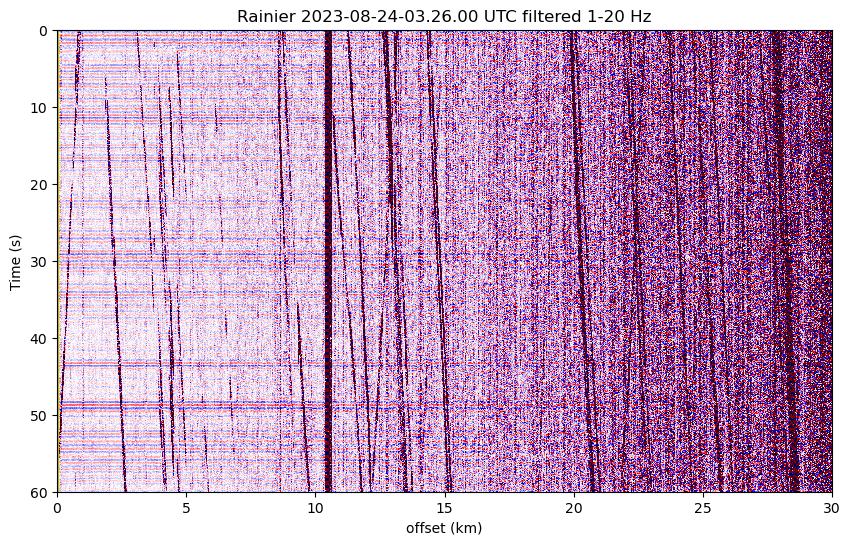

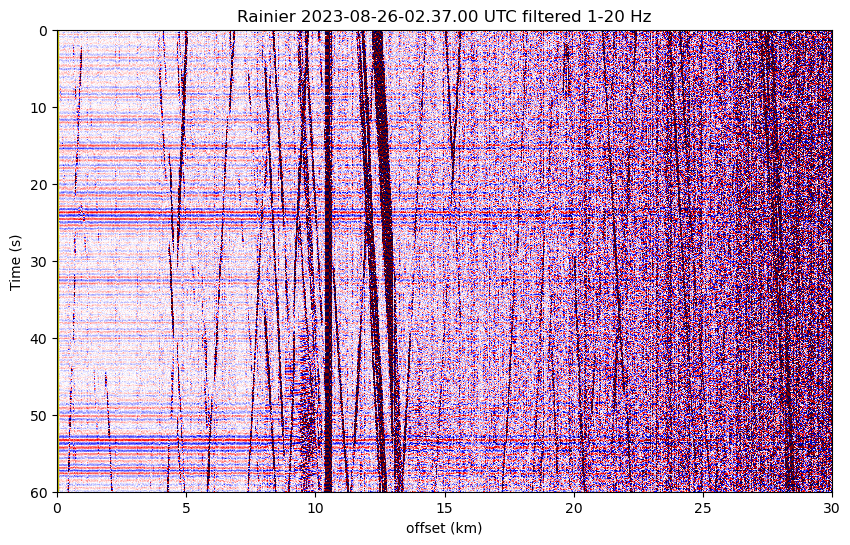

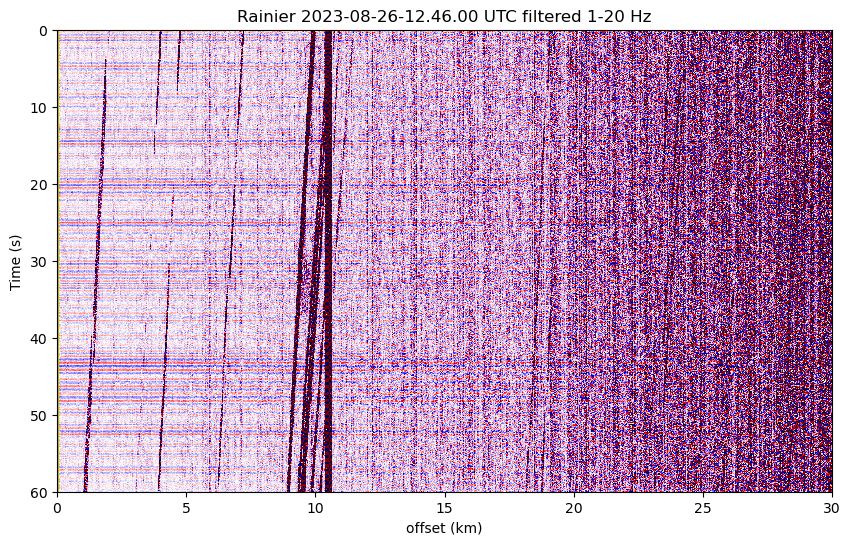

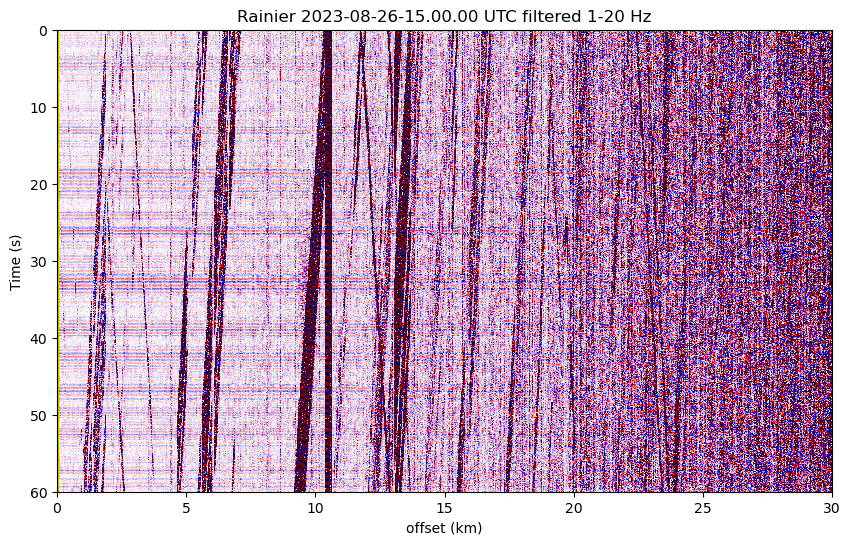

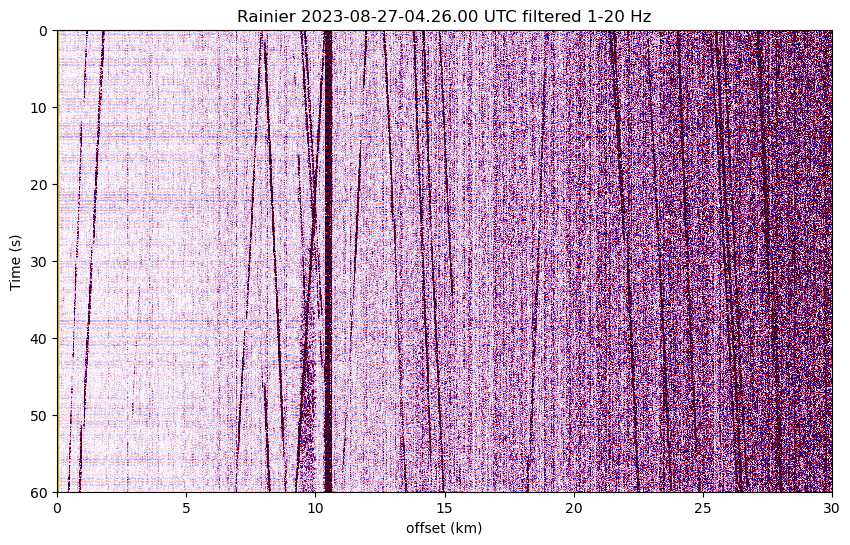

...

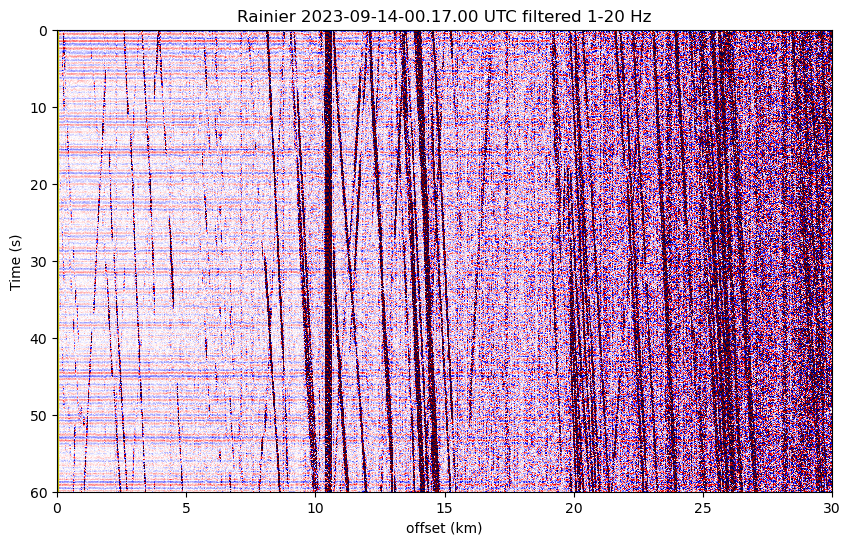

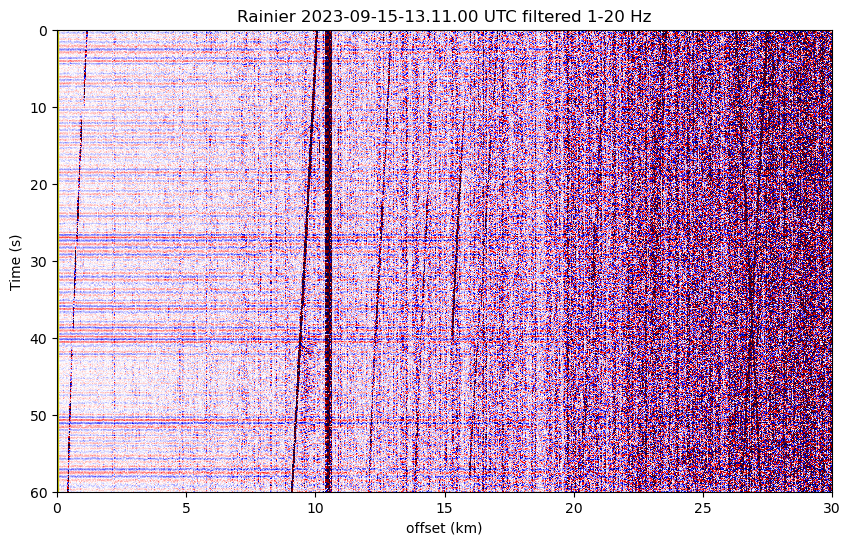

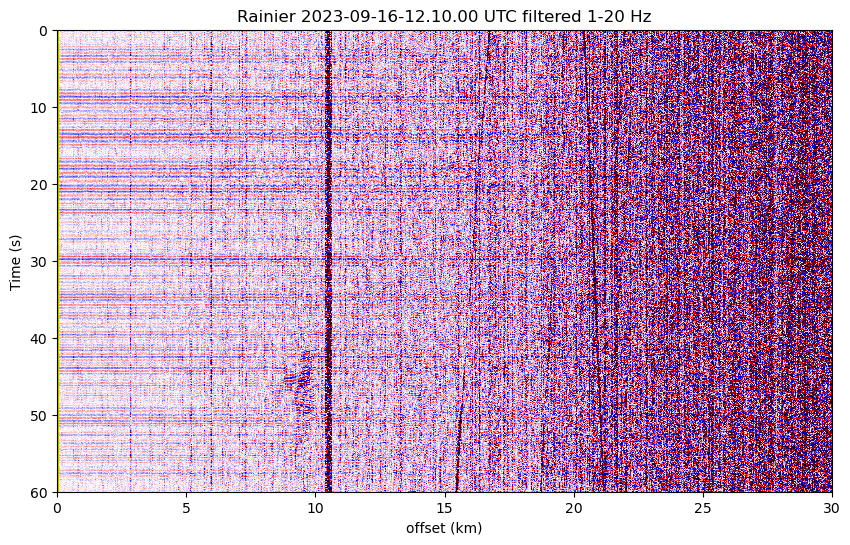

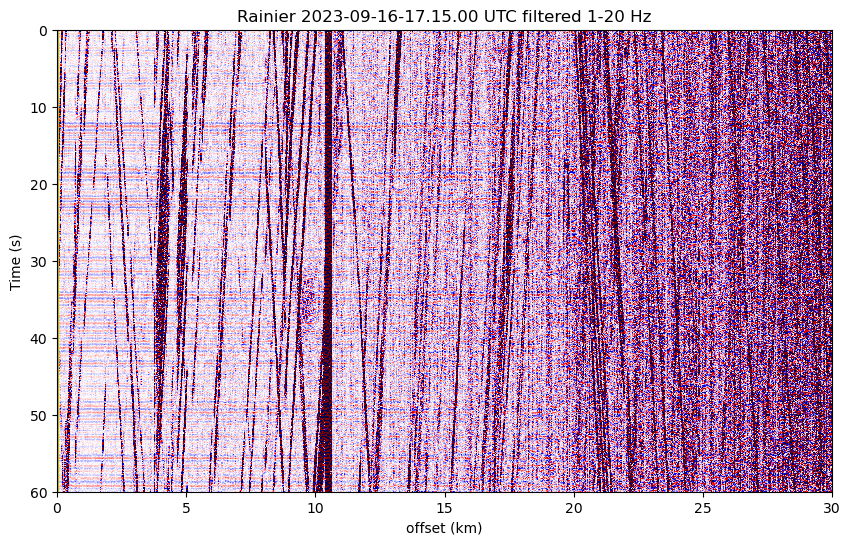

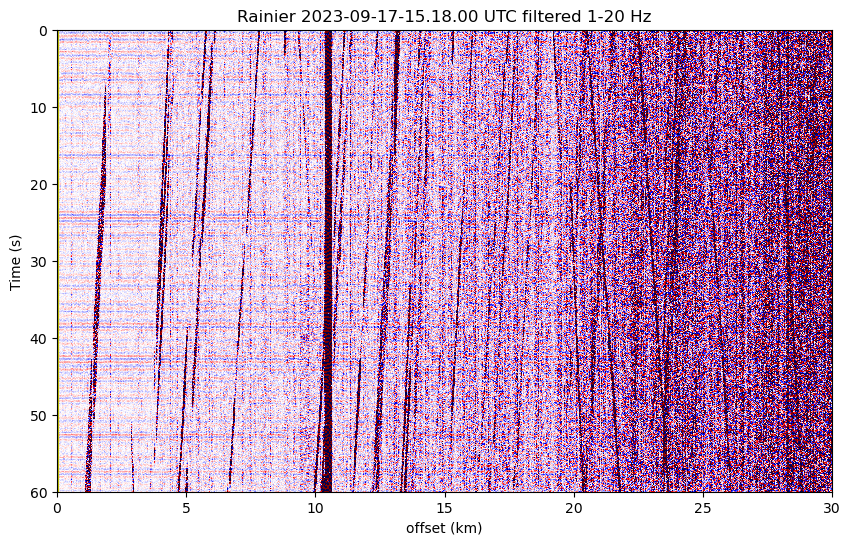

In [8]:
for index, ev in f3.iterrows():
    print(ev['date'])
    
#     # Extract the first column (21 characters wide)
#     first_column = line[:21].strip()
#     #         print(first_column)

#     # Convert the extracted column to a datetime object
    date_object = ev['date'] #datetime.strptime(ev['date'], '%Y/%m/%d %H:%M:%S')
# 
#     # Check if the date is within the specified range
    if datetime(2023, 8, 25) <= date_object <= datetime(2023, 10, 10):
        dir0 = "/1-fnp/petasaur/p-wd15/rainier-10-14-2023-drive1"
        
    if datetime(2023, 10, 14) <= date_object <= datetime(2023, 11, 8):
        dir0 = "/1-fnp/petasaur/p-wd17/rainier/"
        
    if datetime(2023, 11, 10) <= date_object <= datetime(2023, 12, 8):
        dir0 = "/1-fnp/petasaur/p-wd14/rainier/"
        
    elif date_object >= datetime(2023, 10, 10):
        dir0 = "/1-fnp/petasaur/p-wd15/rainier-10-14-2023-drive2"
#     # Print the formatted date as 2023-09-10_09.57.00_UTC.h5
    try:
        file = f"/1-fnp/petasaur/p-wd15/rainier-10-14-2023-drive1/rainier/decimator_" \
          f"{date_object.year}-{zeropad(date_object.month)}-{zeropad(date_object.day)}_" \
          f"{zeropad(date_object.hour)}.{zeropad(date_object.minute)}.00_UTC.h5"

        with h5py.File(file,'r') as fp:
            GL = fp['Acquisition'].attrs['GaugeLength']
            dx = fp['Acquisition'].attrs['SpatialSamplingInterval']
            fs = fp['Acquisition']['Raw[0]'].attrs['OutputDataRate']
            nx = fp['Acquisition']['Raw[0]'].attrs['NumberOfLoci']
            ns = len(fp['Acquisition']['Raw[0]']['RawDataTime'][:])
            #data = fp['Acquisition']['Raw[0]']['RawData'][:]
            #print(file)
            #print('Gauge length (m):',GL)
            #print('Channel spacing (m):',dx)
            #print('Sampling rate (Hz):',fs)
            #print('Num channels:',nx)
            #print('Num samples:',ns)
#         data = h5py.File(file,'r')
#         attrs=dict(data['Acquisition'].attrs)
#         das = np.array(data['Acquisition/Raw[0]/RawData'])
#         time = np.array(data['Acquisition/Raw[0]/RawDataTime'])
#         data.close()
        #dt = 1/fs/2

#         b,a = butter(2,10,'high',fs=das.shape[0]/60)
#         data_hf = filtfilt(b,a,das,axis=0)
#         vm = 0.001

        starttime= ("-").join(file.split('_')[1:3])
        fac=1 # downsampling factor
        tv = psf.data_visualizer(file,1)
        tv.filter_data(fmin,fmax)   
        tv.plot_data(xlims=[0,30],ylims=[60,0],clims=[-0.01,0.01],srcx=0)
        plt.title('Rainier '+starttime + ' UTC filtered ' +str(fmin)+'-'+str(fmax)+' Hz')
        plt.savefig('./plots/'+starttime+'.png')
#             plt.subplots(figsize=(16,9))
#         c=plt.imshow(data_hf,aspect='auto',cmap='seismic',vmin=-vm,vmax=vm,
#                     extent=[0,dx*data_hf.shape[0],0,60])
#         plt.colorbar(c)
#         plt.savefig(file+'.png')
#         plt.show()
    except Exception as e:
        # Handle any other unexpected errors
        print(f"An unexpected error occurred: {e}")
    print('found one!')

In [ ]:
# with h5py.File(fname,'r') as fp:
#     GL = fp['Acquisition'].attrs['GaugeLength']
#     dx = fp['Acquisition'].attrs['SpatialSamplingInterval']
#     fs = fp['Acquisition']['Raw[0]'].attrs['OutputDataRate']
#     nx = fp['Acquisition']['Raw[0]'].attrs['NumberOfLoci']
#     ns = len(fp['Acquisition']['Raw[0]']['RawDataTime'][:])
#     #data = fp['Acquisition']['Raw[0]']['RawData'][:]
#     print(fname)
#     print('Gauge length (m):',GL)
#     print('Channel spacing (m):',dx)
#     print('Sampling rate (Hz):',fs)
#     print('Num channels:',nx)
#     print('Num samples:',ns)

In [ ]:
starttime= ("-").join(fname.split('_')[1:3])
fac=1 # downsampling factor
tv = psf.data_visualizer(fname,1)
tv.filter_data(fmin,fmax)   
tv.plot_data(xlims=[0,30],ylims=[60,0],clims=[-0.01,0.01],srcx=0)
plt.title('Rainier '+starttime + ' UTC filtered ' +str(fmin)+'-'+str(fmax)+' Hz')
plt.savefig('./plots/'+starttime+'.png')

In [ ]:
from scitpy.filter.gaussian import gaussian
def fk_filter(data,vmin=50.,vmax=5000):
    ft = np.fft.fftshift(np.fft.fft2(data))
    f = np.fft.fftshift(np.fft.fftfreq(data.shape[0], d=1/attrs['PulseRate']))
    k = np.fft.fftshift(np.fft.fftfreq(data.shape[1], d=attrs['SpatialSamplingInterval']))

    K,F = np.meshgrid(k,f)
    ft_select = ft.copy()    
    ft_select[(np.abs(F)<vel*np.abs(K))] = 0.
    
    
    myfilter = np.ones_like(ft_select)
    myfilter[(np.abs(F)<vmin*np.abs(K))] = 0.
    myfilter[(np.abs(F)>vmax*np.abs(K))] = 0.
    myfilter=gaussian(myfilter,10)
    myfilter *= myfilter
    
    
    return myfilter

In [ ]:
h5py.__version__

In [ ]:
!pip3 freeze > requirements.txt